## QC and croarse-grain annotation of CD45+ enriched cells 
By Monika Litvinukova <br/>
Latest update 23.07.20

### Import required modules

In [1]:
import bbknn
import anndata
import numpy as np
import pandas as pd
import scanpy as sc
import scipy as sp
import seaborn as sb
from matplotlib import rcParams
from matplotlib import colors
import matplotlib.pyplot as plt

/opt/conda/lib/python3.7/site-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


In [2]:
sc.settings.verbosity = 3
sc.logging.print_version_and_date()
sc.settings.set_figure_params(dpi = 160, color_map = 'RdPu', dpi_save = 180, vector_friendly = True, format = 'svg')

Running Scanpy 1.4.4.post1, on 2020-01-06 16:54.


## Read in data

In [3]:
cd45_raw = sc.read_h5ad('/home/jovyan/data/Jan/0-global/sanger_heart_CD45_QCed_scrublet_cellbender_ctl200101.h5ad')
cd45_raw

AnnData object with n_obs × n_vars = 119493 × 33538 
    obs: 'NRP', 'age_group', 'batch', 'donor', 'gender', 'region', 'sample', 'source', 'type', 'version', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'scrublet_score'
    var: 'gene_ids'

In [4]:
pd.crosstab(cd45_raw.obs['donor'], cd45_raw.obs['region'])

region,AX,LA,LV,RA,RV,SP
donor,,,,,,
D6,13505,14488,7293,2402,4598,14918
D7,19712,1693,1264,2145,3312,3536
D11,10847,3456,2144,0,2475,11705


In [5]:
## remove the samples flagged by Berlin
cd45_raw = cd45_raw[~cd45_raw.obs['sample'].isin(['HCAHeart7850550', 'HCAHeart7827638', 'HCAHeart7606895', 'HCAHeart7964512', 'HCAHeart7827637', 'HCAHeart7827639'])]
cd45_raw

View of AnnData object with n_obs × n_vars = 105192 × 33538 
    obs: 'NRP', 'age_group', 'batch', 'donor', 'gender', 'region', 'sample', 'source', 'type', 'version', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'scrublet_score'
    var: 'gene_ids'

In [14]:
pd.crosstab(cd45_raw.obs['donor'], cd45_raw.obs['region'])

region,AX,LA,LV,RA,RV,SP
donor,,,,,,
D6,13505,14488,7293,2402,4598,14918
D7,5411,1693,1264,2145,3312,3536
D11,10847,3456,2144,0,2475,11705


## Compute QC metrics and filter low quality cells

In [6]:
# Calculate the total counts
cd45_raw.obs['n_counts'].describe()

count    105192.000000
mean       2796.057129
std        3834.500977
min         205.000000
25%         773.000000
50%        1732.000000
75%        3404.000000
max      241637.000000
Name: n_counts, dtype: float64

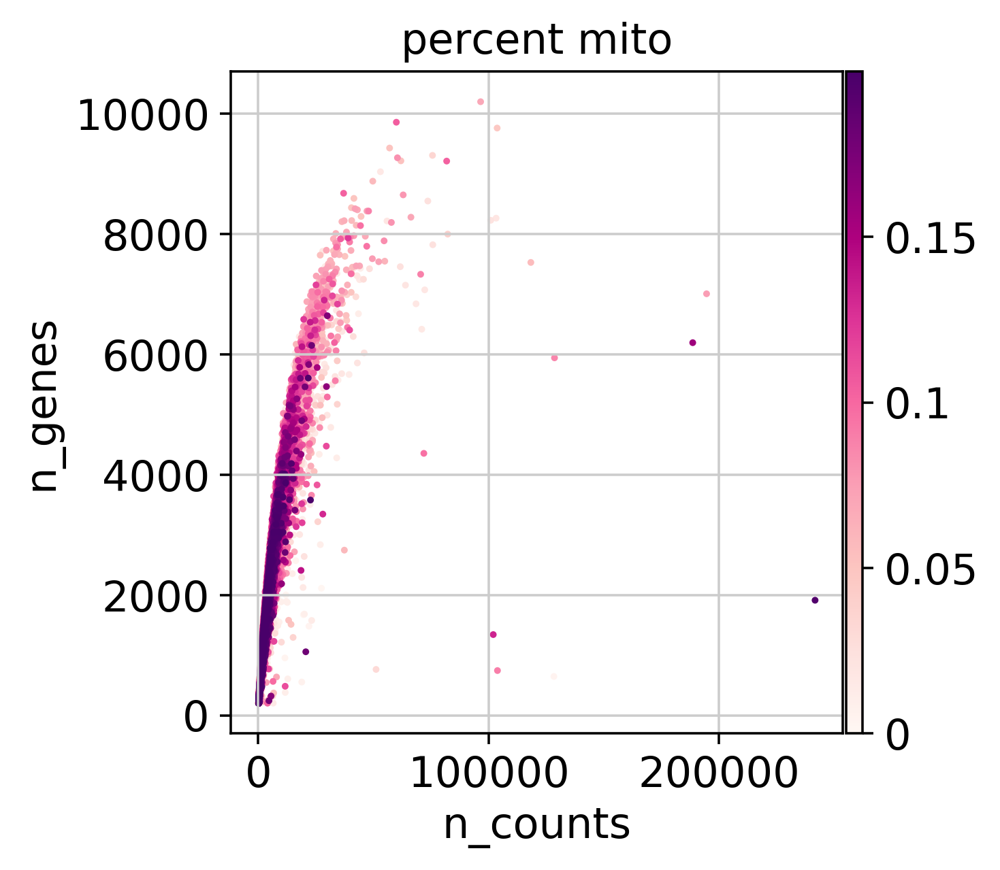

In [7]:
# Data quality summary plots
sc.settings.set_figure_params(dpi = 160, color_map = 'RdPu', dpi_save = 180, vector_friendly = True, format = 'svg')
sc.pl.scatter(cd45_raw, 'n_counts', 'n_genes', color = 'percent_mito', size = 20)

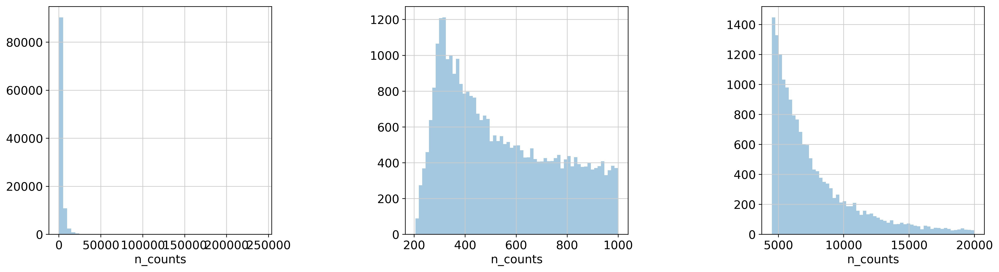

In [8]:
# Thresholding decision: counts

rcParams['figure.figsize'] = (20,5)
fig_ind = np.arange(131, 134)
fig = plt.figure()
fig.subplots_adjust(hspace = 0.4, wspace = 0.6)

sb.distplot(cd45_raw.obs['n_counts'], kde = False, ax = fig.add_subplot(fig_ind[0]))
sb.distplot(cd45_raw.obs['n_counts'][(cd45_raw.obs['n_counts'] > 100) & (cd45_raw.obs['n_counts'] < 1000)], kde = False, bins = 60, ax = fig.add_subplot(fig_ind[1]))
sb.distplot(cd45_raw.obs['n_counts'][(cd45_raw.obs['n_counts'] > 4500) & (cd45_raw.obs['n_counts'] < 20000)], kde = False, bins = 60, ax = fig.add_subplot(fig_ind[2]))

plt.show()

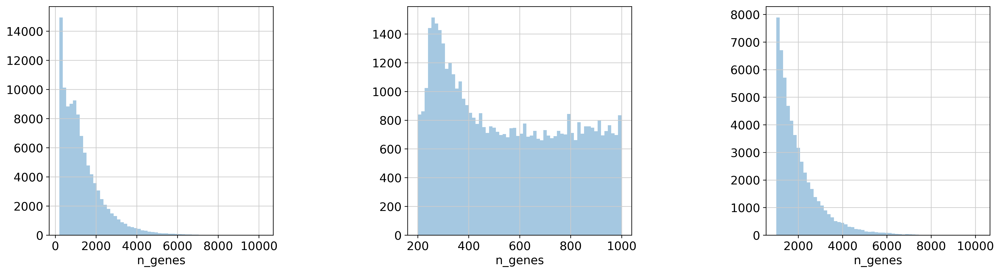

In [9]:
# Thresholding decision: genes

rcParams['figure.figsize']=(20,5)
fig_ind = np.arange(131, 134)
fig = plt.figure()
fig.subplots_adjust(hspace = 0.4, wspace = 0.6)

sb.distplot(cd45_raw.obs['n_genes'], kde = False, bins = 60, ax = fig.add_subplot(fig_ind[0]))
sb.distplot(cd45_raw.obs['n_genes'][cd45_raw.obs['n_genes'] < 1000], kde = False, bins = 60, ax = fig.add_subplot(fig_ind[1]))
sb.distplot(cd45_raw.obs['n_genes'][(cd45_raw.obs['n_genes'] > 1000) & (cd45_raw.obs['n_genes'] < 20000)], kde = False, bins = 60, ax = fig.add_subplot(fig_ind[2]))

plt.show()

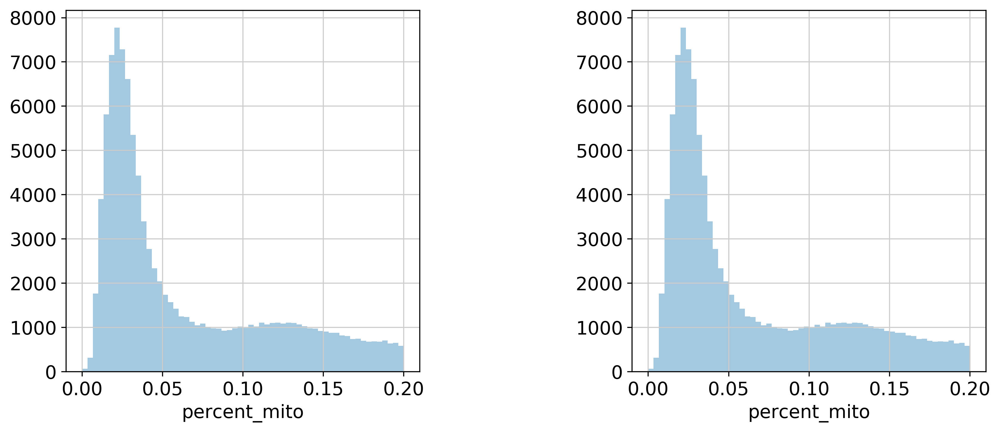

In [10]:
# Thresholding decision: mitochondrial reads

rcParams['figure.figsize']=(20,5)
fig_ind=np.arange(131, 133)
fig = plt.figure()
fig.subplots_adjust(hspace=0.4, wspace=0.6)

sb.distplot(cd45_raw.obs['percent_mito'], kde=False, bins=60, ax=fig.add_subplot(fig_ind[0]))
sb.distplot(cd45_raw.obs['percent_mito'][cd45_raw.obs['percent_mito'] < 0.2], kde=False, bins=60, ax=fig.add_subplot(fig_ind[1]))
plt.show()

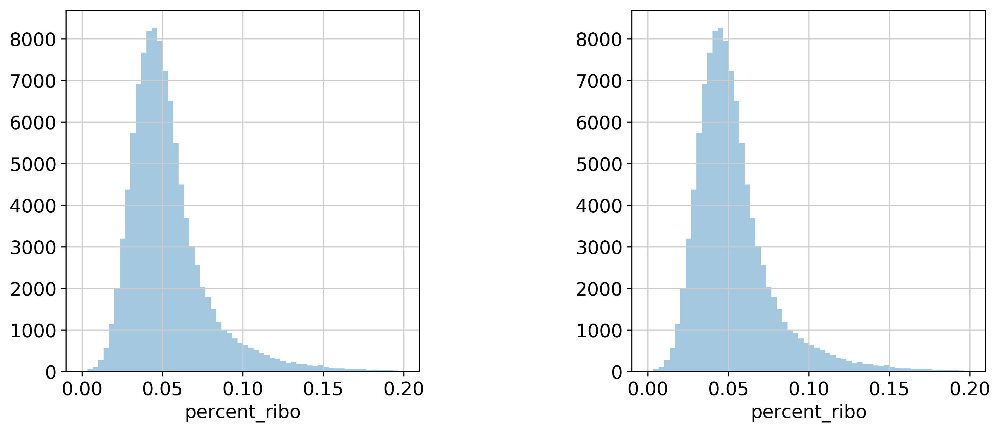

In [11]:
# Thresholding decision: ribosomal reads

rcParams['figure.figsize']=(20,5)
fig_ind=np.arange(131, 133)
fig = plt.figure()
fig.subplots_adjust(hspace=0.4, wspace=0.6)

sb.distplot(cd45_raw.obs['percent_ribo'], kde=False, bins=60, ax=fig.add_subplot(fig_ind[0]))
sb.distplot(cd45_raw.obs['percent_ribo'][cd45_raw.obs['percent_ribo'] < 0.2], kde=False, bins=60, ax=fig.add_subplot(fig_ind[1]))
plt.show()

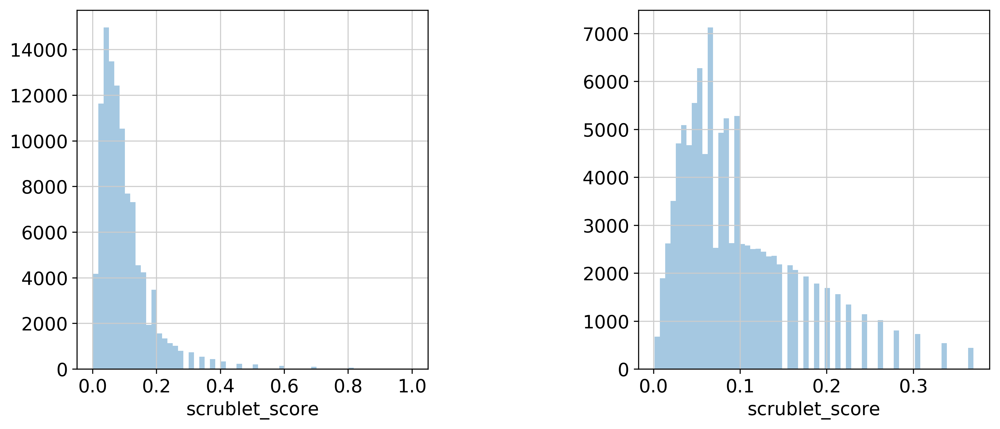

In [12]:
# Thresholding decision: Scrublet

rcParams['figure.figsize']=(20,5)
fig_ind=np.arange(131, 133)
fig = plt.figure()
fig.subplots_adjust(hspace=0.4, wspace=0.6)

sb.distplot(cd45_raw.obs['scrublet_score'], kde=False, bins=60, ax=fig.add_subplot(fig_ind[0]))
sb.distplot(cd45_raw.obs['scrublet_score'][cd45_raw.obs['scrublet_score'] < 0.4], kde=False, bins=60, ax=fig.add_subplot(fig_ind[1]))
plt.show()

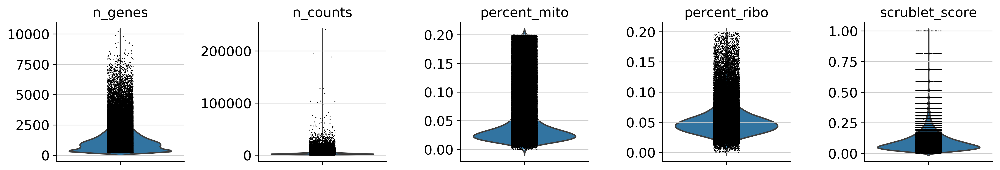

In [13]:
sc.pl.violin(cd45_raw, ['n_genes', 'n_counts', 'percent_mito', 'percent_ribo', 'scrublet_score'], jitter = 0.1, multi_panel = True)

In [15]:
cd45_filtered = cd45_raw.copy()

In [16]:
# Filter cells according to identified QC thresholds:
print('Total number of cells before filtering: {:d}'.format(cd45_filtered.n_obs))

sc.pp.filter_cells(cd45_filtered, min_counts = 500)
sc.pp.filter_cells(cd45_filtered, max_counts = 15000)
sc.pp.filter_cells(cd45_filtered, min_genes = 300)
sc.pp.filter_cells(cd45_filtered, max_genes = 6000)
cd45_filtered = cd45_filtered[cd45_filtered.obs['scrublet_score'] < 0.3]

print('Total number of cells after filtering: {:d}'.format(cd45_filtered.n_obs))

#Filter genes:
print('Total number of genes: {:d}'.format(cd45_filtered.n_vars))

Total number of cells before filtering: 105192
filtered out 16699 cells that haveless than 500 counts
filtered out 1528 cells that havemore than 15000 counts
filtered out 42 cells that haveless than 300 genes expressed
Total number of cells after filtering: 84397
Total number of genes: 33538


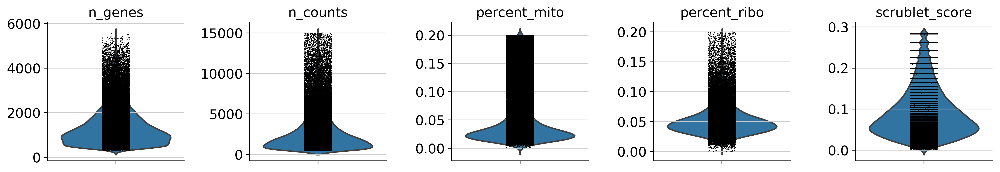

In [17]:
sc.pl.violin(cd45_filtered, ['n_genes', 'n_counts', 'percent_mito', 'percent_ribo', 'scrublet_score'], jitter = 0.1, multi_panel = True)

## Pre-process the dataset

In [18]:
cd45_processed = cd45_filtered.copy()
sc.pp.normalize_per_cell(cd45_processed, counts_per_cell_after = 1e4)
sc.pp.log1p(cd45_processed)
cd45_processed.raw = cd45_processed.copy()
cd45_processed.shape

normalizing by total count per cell
    finished (0:00:01): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


(84397, 33538)

In [19]:
sc.pp.highly_variable_genes(cd45_processed, flavor = 'seurat')
cd45_hvg = cd45_processed[:, cd45_processed.var['highly_variable']]
cd45_hvg.shape

extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


(84397, 1563)

In [20]:
sc.pp.scale(cd45_hvg, max_value = 10)

/opt/conda/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:869: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [21]:
sc.pp.pca(cd45_hvg, n_comps = 50, use_highly_variable = True, svd_solver = 'arpack')
sc.pp.neighbors(cd45_hvg)
sc.tl.umap(cd45_hvg)

computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:16)
computing neighbors
    using 'X_pca' with n_pcs = 50


/opt/conda/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../opt/conda/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  self.func_ir.loc))
/opt/conda/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../opt/conda/lib/python3.7/site-packages/umap/utils.py", line 409:
@numba.njit(parall

    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:35)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:54)


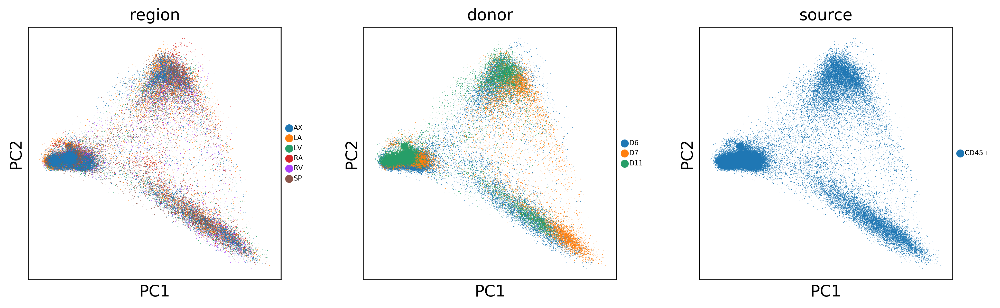

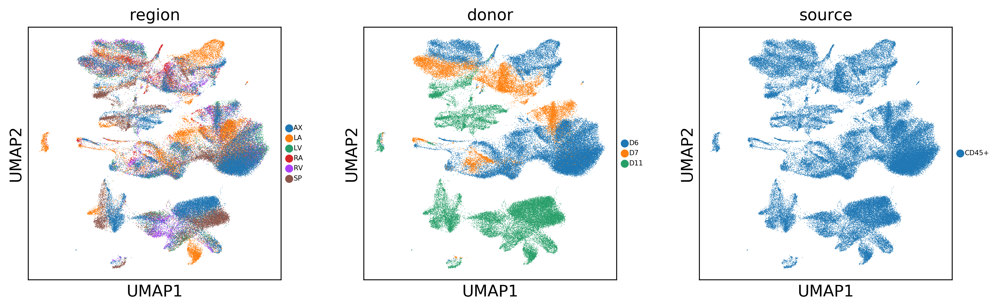

In [22]:
sc.settings.set_figure_params(dpi = 160, color_map = 'RdPu', dpi_save = 180, vector_friendly = True, format = 'svg')
sc.pl.pca_scatter(cd45_hvg, color = ['region', 'donor', 'source'], size = 1, legend_fontsize = 6)
sc.pl.umap(cd45_hvg, color = ['region', 'donor', 'source'], size = 1, legend_fontsize = 6)

## Batch correction

In [23]:
def regress_pca(pca, batch):
    regressors = np.zeros(pca.shape, dtype = 'float64')
    regressed = np.zeros(pca.shape, dtype = 'float64')
    for category in np.unique(batch):
        mask = (category == batch)
        regressors[mask,:] = np.mean(pca[mask,:],axis = 0)
    for i in range(pca.shape[1]):
        t = np.c_[np.ones(regressors[:,i].shape),regressors[:,i]]
        b = np.dot(np.dot(np.linalg.inv(np.dot(t.T,t)),t.T),pca[:,i])
        regressed[:,i] = pca[:,i] - b[0] - b[1] * t[:,1]
    return regressed

- donor

In [24]:
lrkp9_donor = cd45_hvg.copy()
lrkp9_donor.obsm['X_pca_original'] = lrkp9_donor.obsm['X_pca'].copy()
lrkp9_donor.obsm['X_pca'] = regress_pca(lrkp9_donor.obsm['X_pca'], lrkp9_donor.obs['donor'])

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:32)


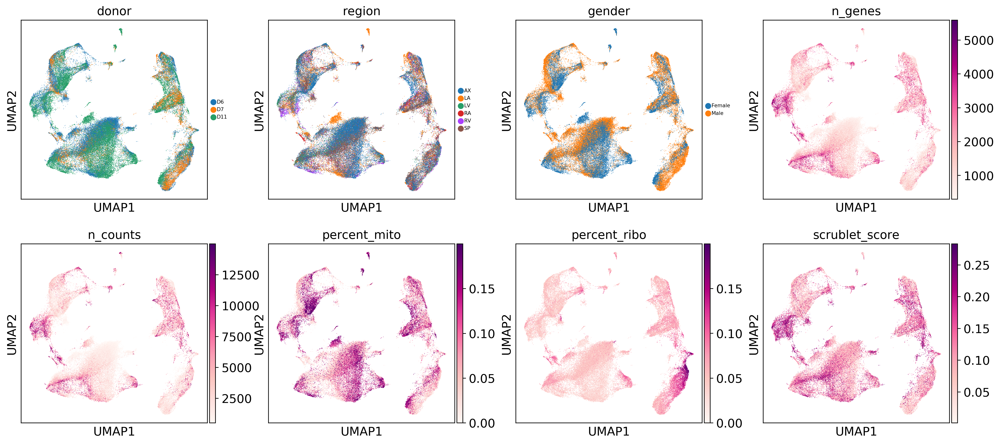

In [37]:
#bbknn_donor = bbknn.bbknn(lrkp9_donor, neighbors_within_batch = 4, batch_key = 'donor', approx = True, copy = True, n_trees = 30)
sc.tl.umap(bbknn_donor, min_dist = 0.05, spread = 3, random_state = 1712)
sc.pl.umap(bbknn_donor, color = ['donor', 'region', 'gender', 'n_genes', 'n_counts', 'percent_mito', 'percent_ribo', 'scrublet_score'], size = 1, legend_fontsize = 6, color_map = 'RdPu')

running Leiden clustering
    finished: found 20 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:01:44)


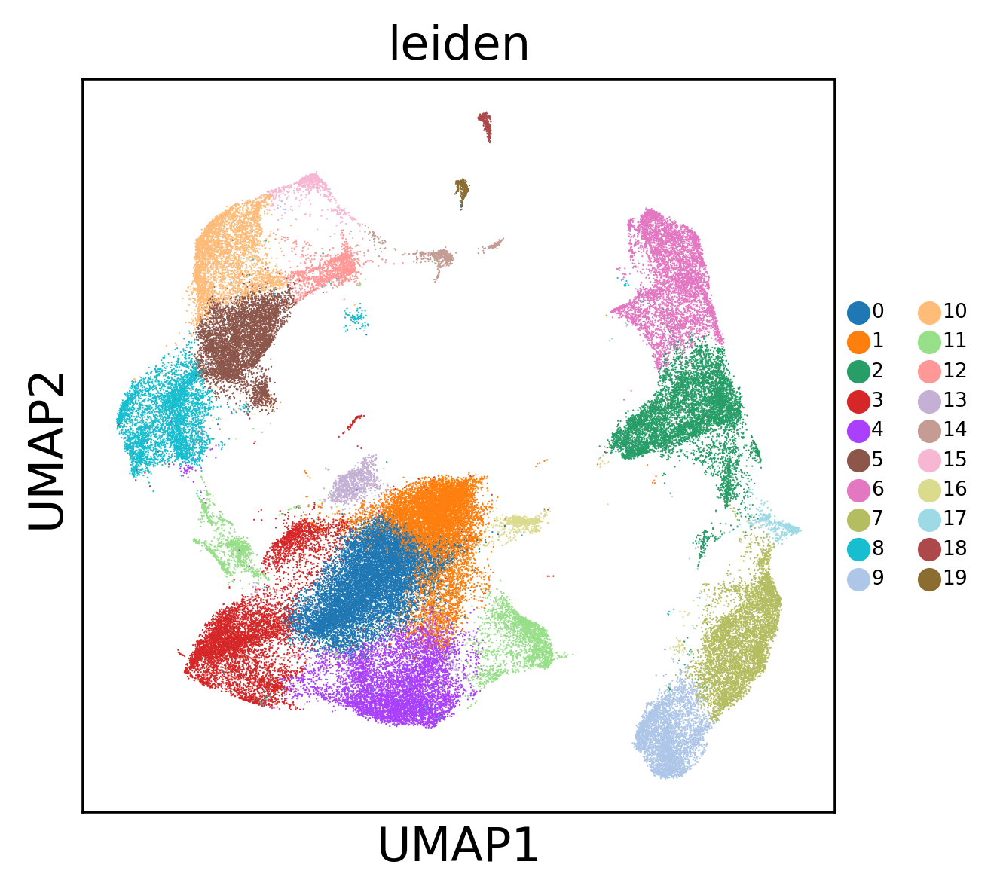

In [55]:
sc.tl.leiden(bbknn_donor, resolution = 1, random_state = 1712)
sc.pl.umap(bbknn_donor, color = ['leiden'], size = 1, legend_fontsize = 6, color_map = 'RdPu')

## Annotate the dataset

In [56]:
sc.pl.umap(bbknn_donor, color = ['leiden', 'VWF', 'CA4', 'NPPA', 'CXCL2', 'POSTN', 'ACKR1', 'SEMA3G', 'PROX1', 'TBX1', 'CXCL1', 'CD14', 'C1QA', 'MRC1', 'CD3E', 'NKG7', 'HBB', 'CD79A', 'BANK1', 
                                 'MS4A2', 'CPA3', 'PDGFRA', 'DCN', 'MYH11', 'TAGLN', 'ICAM1', 'ABCC9', 'KCNJ8', 'THBS4', 'CALB2', 'TTN', 'PLP1', 'GFRA3', 'GPAM', 'ATF3', 'MSLN'], size = 1, legend_fontsize = 6)

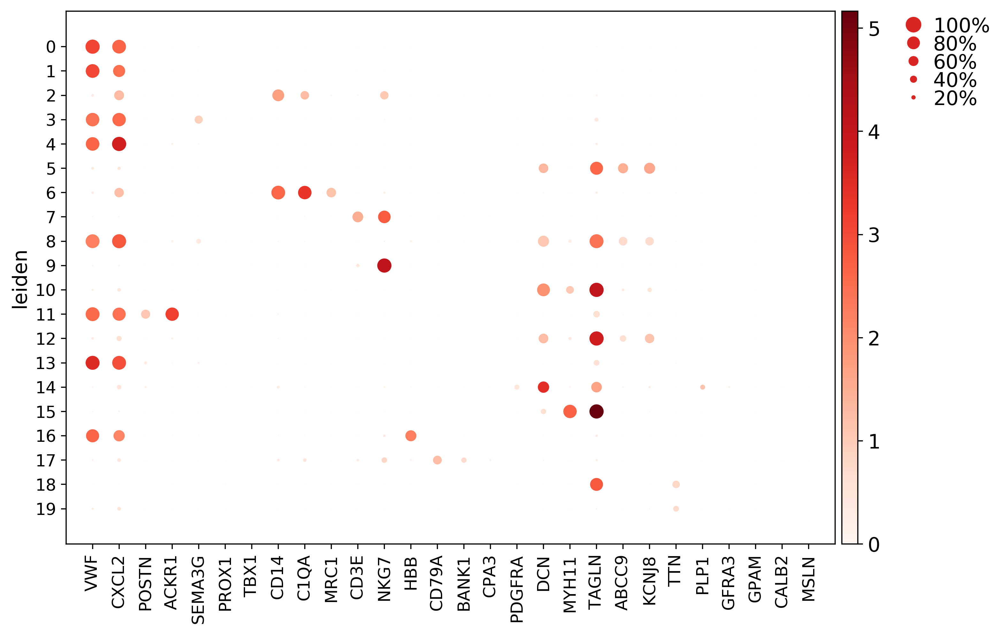

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[9.799999999999999, 0, 0.2, 0.5, 0.25])

In [57]:
annotation = ['VWF', 'CXCL2', 'POSTN', 'ACKR1', 'SEMA3G', 'PROX1', 'TBX1', 'CD14', 'C1QA', 'MRC1', 'CD3E', 'NKG7', 'HBB', 'CD79A', 
              'BANK1', 'CPA3', 'PDGFRA', 'DCN', 'MYH11', 'TAGLN', 'ABCC9', 'KCNJ8', 'TTN', 'PLP1', 'GFRA3', 'GPAM', 'CALB2', 'MSLN']
sc.pl.dotplot(bbknn_donor, annotation, groupby = 'leiden')

### Call markers on leiden

In [48]:
sc.tl.rank_genes_groups(bbknn_donor, 'leiden', method = 'wilcoxon', use_raw = True)
result = bbknn_donor.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_clusters = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})
wilcox_clusters.to_csv('/home/jovyan/data/Jan/0-global/hca_heart_CD45_ml200106_wilcox.csv', index = False, sep = ',')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:04:49)


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


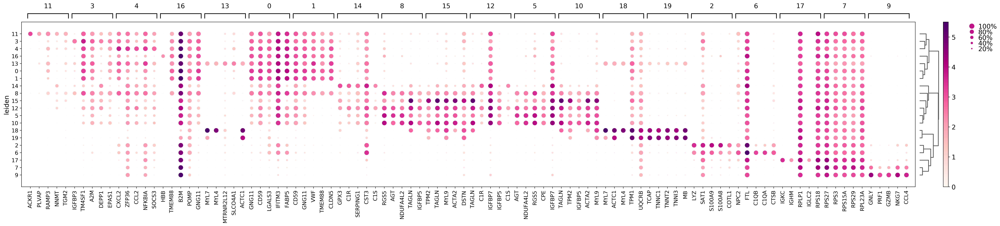

In [49]:
sc.pl.rank_genes_groups_dotplot(bbknn_donor, n_genes = 5, color_map = 'RdPu')

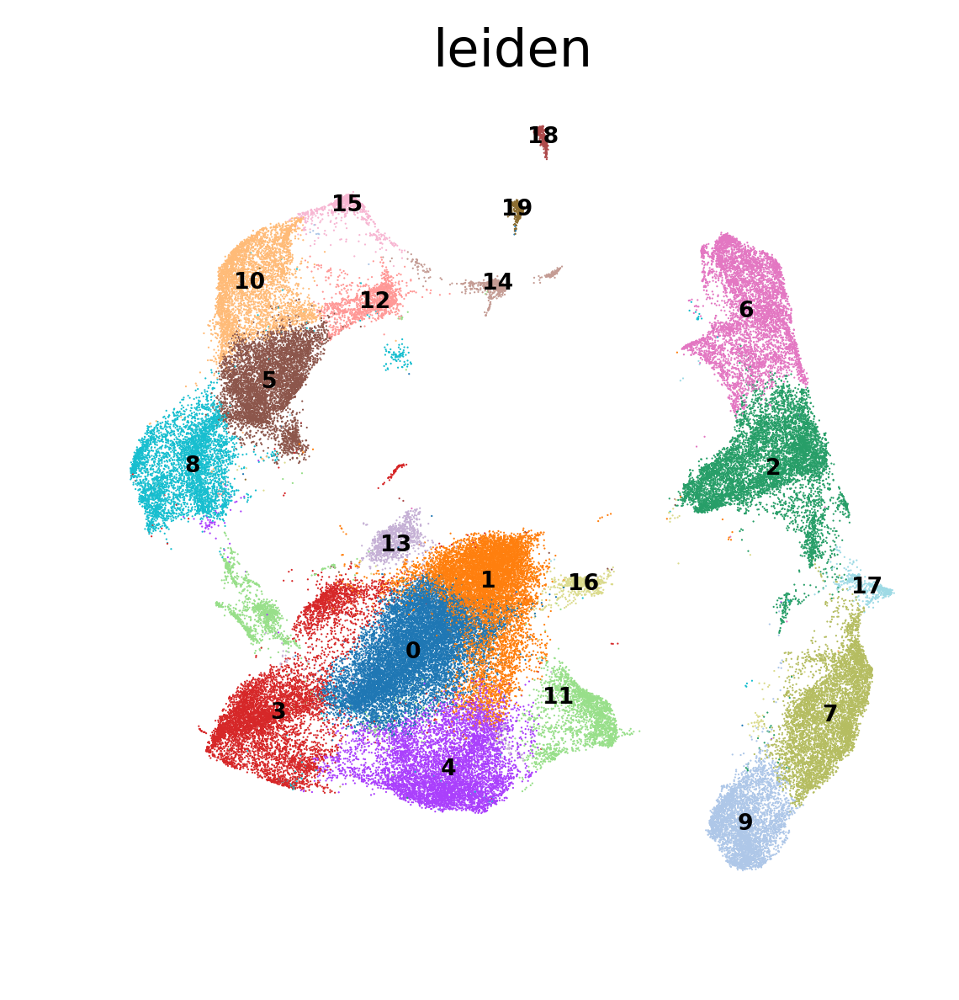

In [50]:
sc.pl.umap(bbknn_donor, color = ['leiden'], size = 1, legend_fontsize = 6, legend_loc = 'on data', frameon = False)

In [51]:
bbknn_donor.obs['leiden'].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19'],
      dtype='object')

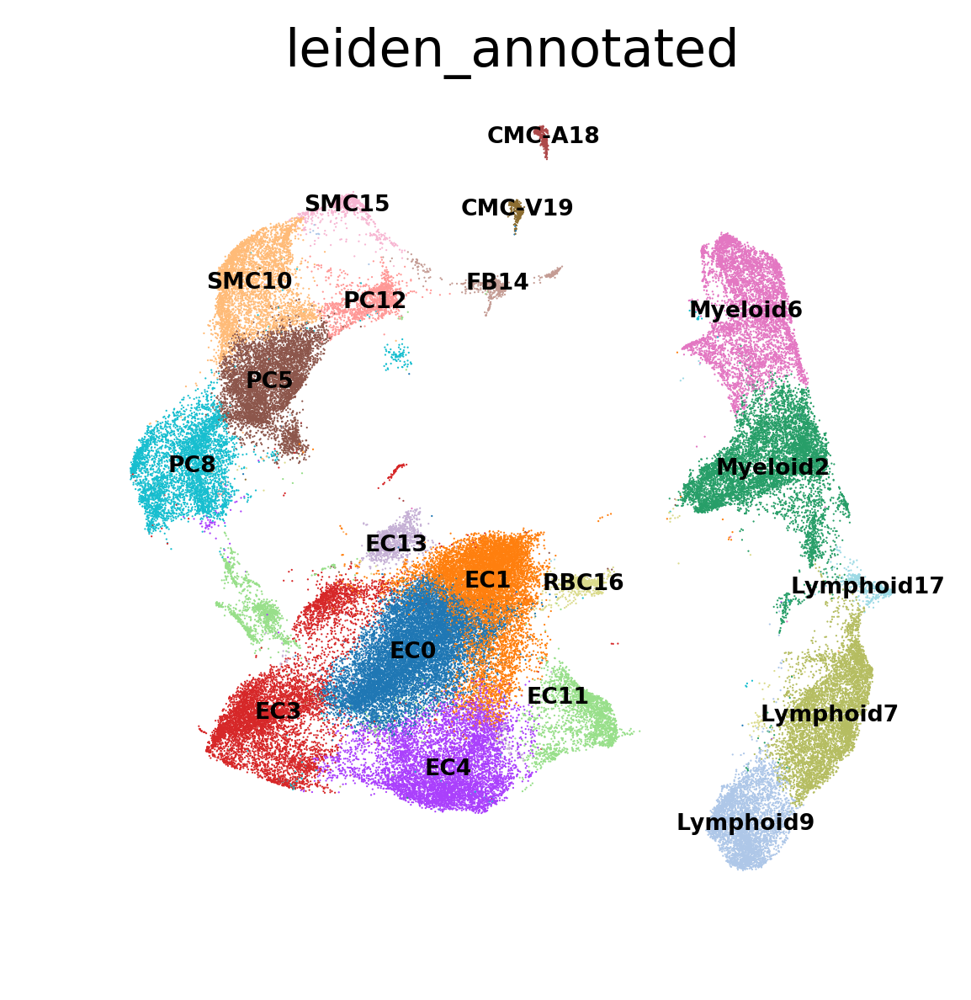

In [58]:
bbknn_donor.obs['leiden_annotated'] = bbknn_donor.obs['leiden']
bbknn_donor.obs['leiden_annotated'].cat.categories = ['EC0', 'EC1', 'Myeloid2', 'EC3', 'EC4', 'PC5', 'Myeloid6', 'Lymphoid7', 'PC8', 'Lymphoid9', 
                                                      'SMC10', 'EC11', 'PC12', 'EC13', 'FB14', 'SMC15', 'RBC16', 'Lymphoid17', 'CMC-A18', 'CMC-V19']
sc.pl.umap(bbknn_donor, color = ['leiden_annotated'], size = 1, legend_fontsize = 6, legend_loc = 'on data', frameon = False)

In [59]:
## Create a new object with main matrix containing log-transformed HVG, raw containing non-transformed counts.
cd45_export = anndata.AnnData(X = bbknn_donor.X, obs = bbknn_donor.obs , var = bbknn_donor.var, obsm = bbknn_donor.obsm)
cd45_export.raw = cd45_filtered.copy()
cd45_export

AnnData object with n_obs × n_vars = 84397 × 1563 
    obs: 'NRP', 'age_group', 'batch', 'donor', 'gender', 'region', 'sample', 'source', 'type', 'version', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'scrublet_score', 'leiden', 'leiden_annotated'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    obsm: 'X_pca', 'X_umap', 'X_pca_original'

In [60]:
cd45_export.raw.shape

(84397, 33538)

In [ ]:
cd45_export.write('/home/jovyan/data/Dec/0-global/hca_heart_CD45_annotated_ml191209.h5ad')

In [ ]:
samplexcell = pd.crosstab(bbknn_donor.obs['sample'], bbknn_donor.obs['leiden_annotated'])
samplexcell.to_csv('/home/jovyan/data/Dec/0-global/hca_heart_CD45_annotated_ml191209_tabulated.csv', index = True)